In [2]:
import keras
import tensorflow as tf
import gdal
import os
import matplotlib.pyplot as plt
import numpy as np
from pathlib import Path
from keras_unet.models import custom_unet, satellite_unet
from keras_unet.metrics import iou, iou_thresholded
from keras_unet.losses import jaccard_distance
from keras_unet.utils import plot_segm_history

2023-07-12 13:44:13.798776: I tensorflow/core/util/port.cc:110] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2023-07-12 13:44:13.800335: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2023-07-12 13:44:13.832208: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2023-07-12 13:44:13.832589: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F AVX512_VNNI FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-07-12 13:44:14.469838: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Co

-----------------------------------------
keras-unet init: TF version is >= 2.0.0 - using `tf.keras` instead of `Keras`
-----------------------------------------


In [3]:
base_dir = Path(r'/media/studentuser/PATRIOT/training')
mask_dir = base_dir.joinpath('masks_img')
image_dir = base_dir.joinpath('img')
water_dir = mask_dir.joinpath('water_img')
shrubs_dir = mask_dir.joinpath('shrubs_img')
poly_dir = mask_dir.joinpath('polygonal_img')
trees_dir = mask_dir.joinpath('trees_img')
low_dir = mask_dir.joinpath('low_density_img')

In [4]:
def make_path(img_dir, prefix, number):
    return os.path.join(img_dir, f"{prefix}_{number}.tif")

In [5]:
def img_number(fpath: str) -> int:
    return int(os.path.splitext(os.path.split(fpath)[1])[0].split('_')[-1])

In [6]:
def load_image(path: str) -> np.ndarray:
    ds = gdal.Open(path, gdal.GA_ReadOnly)
    return ds.GetRasterBand(1).ReadAsArray()

In [7]:
def load_stack(shape, dtype, img_dir, prefix):
    stack = np.zeros(shape = shape, dtype = dtype)
    for i in range(shape[0]):
        image_path = make_path(img_dir, prefix, i + 1)
        stack[i, :, :] = load_image(image_path)
    return stack

def load_stack_safely(shape, dtype, img_dir, prefix):
    stack = np.zeros(shape = shape, dtype = dtype)
    for i in range(shape[0]):
        image_path = make_path(img_dir, prefix, i + 1)
        if not os.path.isfile(image_path):
            print("skipping", image_path)
            continue
        stack[i, :, :] = load_image(image_path)
    return stack

In [8]:
I = 200
N = 256
M = 256
V = 5

In [9]:
train_images = load_stack((I, N, M), np.float32, image_dir, "img")
train_images_R = train_images.reshape(I, N, M, 1)

In [10]:
train_images_R.shape

(200, 256, 256, 1)

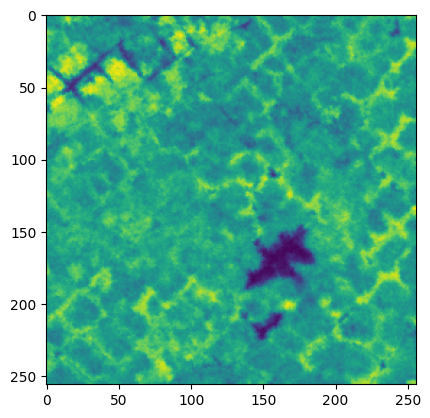

In [11]:
plt.imshow(train_images[1, :,:])

In [12]:
water_mask = load_stack_safely((I, N, M), np.int8, water_dir, "water")
poly_mask = load_stack_safely((I, N, M), np.int8, poly_dir, "polygonal")
trees_mask = load_stack_safely((I, N, M), np.int8, trees_dir, "tree")
shrubs_mask = load_stack_safely((I, N, M), np.int8, shrubs_dir, "shrub")
low_mask = load_stack_safely((I, N, M), np.int8, low_dir, "low")

skipping /media/studentuser/PATRIOT/training/masks_img/water_img/water_2.tif
skipping /media/studentuser/PATRIOT/training/masks_img/water_img/water_7.tif
skipping /media/studentuser/PATRIOT/training/masks_img/water_img/water_10.tif
skipping /media/studentuser/PATRIOT/training/masks_img/water_img/water_13.tif
skipping /media/studentuser/PATRIOT/training/masks_img/water_img/water_15.tif
skipping /media/studentuser/PATRIOT/training/masks_img/water_img/water_22.tif
skipping /media/studentuser/PATRIOT/training/masks_img/water_img/water_23.tif
skipping /media/studentuser/PATRIOT/training/masks_img/water_img/water_24.tif
skipping /media/studentuser/PATRIOT/training/masks_img/water_img/water_35.tif
skipping /media/studentuser/PATRIOT/training/masks_img/water_img/water_36.tif
skipping /media/studentuser/PATRIOT/training/masks_img/water_img/water_38.tif
skipping /media/studentuser/PATRIOT/training/masks_img/water_img/water_40.tif
skipping /media/studentuser/PATRIOT/training/masks_img/water_img/w

skipping /media/studentuser/PATRIOT/training/masks_img/trees_img/tree_166.tif
skipping /media/studentuser/PATRIOT/training/masks_img/trees_img/tree_168.tif
skipping /media/studentuser/PATRIOT/training/masks_img/trees_img/tree_169.tif
skipping /media/studentuser/PATRIOT/training/masks_img/trees_img/tree_170.tif
skipping /media/studentuser/PATRIOT/training/masks_img/trees_img/tree_171.tif
skipping /media/studentuser/PATRIOT/training/masks_img/trees_img/tree_173.tif
skipping /media/studentuser/PATRIOT/training/masks_img/trees_img/tree_174.tif
skipping /media/studentuser/PATRIOT/training/masks_img/trees_img/tree_175.tif
skipping /media/studentuser/PATRIOT/training/masks_img/trees_img/tree_177.tif
skipping /media/studentuser/PATRIOT/training/masks_img/trees_img/tree_178.tif
skipping /media/studentuser/PATRIOT/training/masks_img/trees_img/tree_179.tif
skipping /media/studentuser/PATRIOT/training/masks_img/trees_img/tree_180.tif
skipping /media/studentuser/PATRIOT/training/masks_img/trees_img

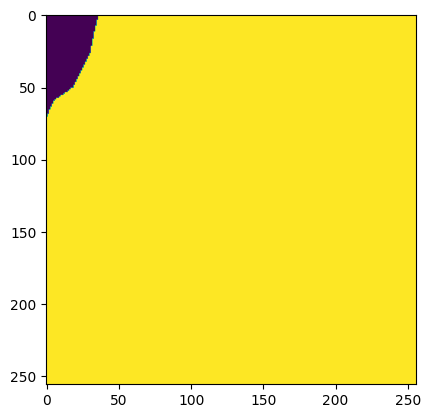

In [13]:
plt.imshow(low_mask[165, :,:])

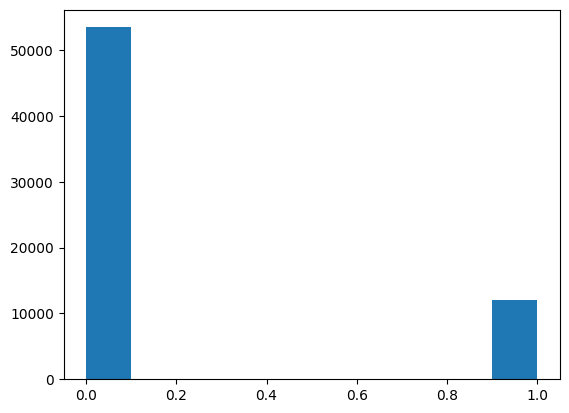

In [14]:
plt.hist(poly_mask[0, :,:].flatten())
plt.show()

In [15]:
model = satellite_unet((N, M, 1), V)

2023-07-12 13:44:24.066614: W tensorflow/core/common_runtime/gpu/gpu_device.cc:1956] Cannot dlopen some GPU libraries. Please make sure the missing libraries mentioned above are installed properly if you would like to use GPU. Follow the guide at https://www.tensorflow.org/install/gpu for how to download and setup the required libraries for your platform.
Skipping registering GPU devices...


In [16]:
model.compile(
    optimizer = tf.keras.optimizers.Adam(),
    loss = "binary_crossentropy",
    metrics = [iou, iou_thresholded],
)

In [17]:
# Image 13 held out due to low image quality from smoke

W = 159
Y = np.zeros(shape=(W, N, M, 5), dtype =np.int8)
Y_train_img = np.zeros(shape=(W, N, M, 1), dtype =np.float32)

Y[0:12, :, :, 0] = trees_mask[0:12, :, :]
Y[0:12, :, :, 1] = poly_mask[0:12, :, :]
Y[0:12, :, :, 2] = water_mask[0:12, :, :]
Y[0:12, :, :, 3] = shrubs_mask[0:12, :, :]
Y[0:12, :, :, 4] = low_mask[0:12, :, :]
Y_train_img[0:12, :, :, 0] = train_images_R[0:12, :, :, 0]

Y[12:W, :, :, 0] = trees_mask[13:W+1, :, :]
Y[12:W, :, :, 1] = poly_mask[13:W+1, :, :]
Y[12:W, :, :, 2] = water_mask[13:W+1, :, :]
Y[12:W, :, :, 3] = shrubs_mask[13:W+1, :, :]
Y[12:W, :, :, 4] = low_mask[13:W+1, :, :]
Y_train_img[12:W, :, :, 0] = train_images_R[13:W+1, :, :, 0]

In [18]:
# Image 175 held out due to low image quality from smoke

K = 39
Y_valid = np.zeros(shape=(K, N, M, V), dtype =np.int8)
Y_valid_img = np.zeros(shape=(K, N, M, 1), dtype =np.float32)

Y_valid[0:14, :, :, 0] = trees_mask[160:174, :, :]
Y_valid[0:14, :, :, 1] = poly_mask[160:174, :, :]
Y_valid[0:14, :, :, 2] = water_mask[160:174, :, :]
Y_valid[0:14, :, :, 3] = shrubs_mask[160:174, :, :]
Y_valid[0:14, :, :, 4] = low_mask[160:174, :, :]
Y_valid_img[0:14, :, :, 0] = train_images_R[160:174, :, :, 0]

Y_valid[14:K, :, :, 0] = trees_mask[175:200, :, :]
Y_valid[14:K, :, :, 1] = poly_mask[175:200, :, :]
Y_valid[14:K, :, :, 2] = water_mask[175:200, :, :]
Y_valid[14:K, :, :, 3] = shrubs_mask[175:200, :, :]
Y_valid[14:K, :, :, 4] = low_mask[175:200, :, :]
Y_valid_img[14:K, :, :, 0] = train_images_R[175:200, :, :, 0]

In [19]:
low_mask[46, :,:]

array([[1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1],
       ...,
       [1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1]], dtype=int8)

In [20]:
Y[45,:,:,4]

array([[1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1],
       ...,
       [1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1]], dtype=int8)

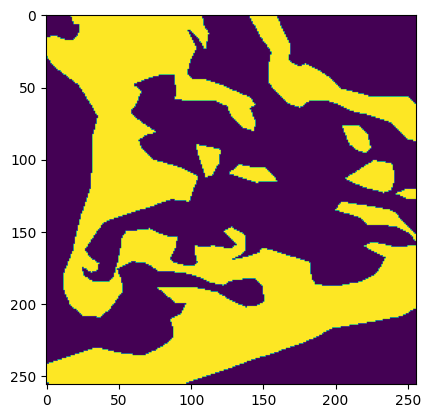

In [21]:
plt.imshow(Y[10,:,:,4])

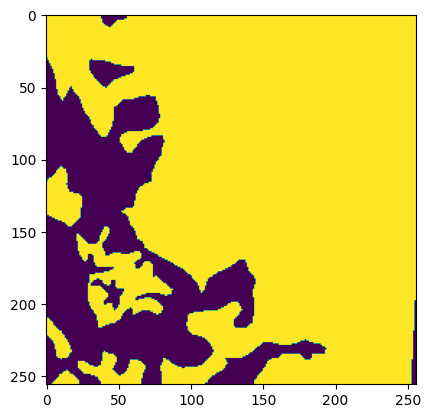

In [22]:
plt.imshow(water_mask[11,:, :])

In [23]:
Y_valid_img.shape

(39, 256, 256, 1)

In [24]:
Y.shape

(159, 256, 256, 5)

In [25]:
history = model.fit(Y_train_img, Y, epochs = 200)

Epoch 1/200
5/5 [==============================] - 27s 4s/step - loss: 0.5757 - iou: 0.1506 - iou_thresholded: 0.1761
Epoch 2/200
5/5 [==============================] - 21s 4s/step - loss: 0.3087 - iou: 0.2130 - iou_thresholded: 0.2227
Epoch 3/200
5/5 [==============================] - 20s 4s/step - loss: 0.2835 - iou: 0.2609 - iou_thresholded: 0.3208
Epoch 4/200
5/5 [==============================] - 20s 4s/step - loss: 0.2653 - iou: 0.2716 - iou_thresholded: 0.2987
Epoch 5/200
5/5 [==============================] - 20s 4s/step - loss: 0.2627 - iou: 0.2796 - iou_thresholded: 0.3380
Epoch 6/200
5/5 [==============================] - 20s 4s/step - loss: 0.2584 - iou: 0.2872 - iou_thresholded: 0.3251
Epoch 7/200
5/5 [==============================] - 21s 4s/step - loss: 0.2442 - iou: 0.3061 - iou_thresholded: 0.3617
Epoch 8/200
5/5 [==============================] - 21s 4s/step - loss: 0.2383 - iou: 0.2994 - iou_thresholded: 0.3356
Epoch 9/200
5/5 [==============================] - 21s 4

5/5 [==============================] - 21s 4s/step - loss: 0.1438 - iou: 0.5033 - iou_thresholded: 0.6217
Epoch 70/200
5/5 [==============================] - 20s 4s/step - loss: 0.1389 - iou: 0.5223 - iou_thresholded: 0.6293
Epoch 71/200
5/5 [==============================] - 20s 4s/step - loss: 0.1284 - iou: 0.5476 - iou_thresholded: 0.6587
Epoch 72/200
5/5 [==============================] - 21s 4s/step - loss: 0.1387 - iou: 0.5396 - iou_thresholded: 0.6442
Epoch 73/200
5/5 [==============================] - 21s 4s/step - loss: 0.1558 - iou: 0.5123 - iou_thresholded: 0.6028
Epoch 74/200
5/5 [==============================] - 20s 4s/step - loss: 0.1283 - iou: 0.5576 - iou_thresholded: 0.6661
Epoch 75/200
5/5 [==============================] - 20s 4s/step - loss: 0.1165 - iou: 0.5637 - iou_thresholded: 0.6874
Epoch 76/200
5/5 [==============================] - 20s 4s/step - loss: 0.1207 - iou: 0.5744 - iou_thresholded: 0.6861
Epoch 77/200
5/5 [==============================] - 21s 4s/st

5/5 [==============================] - 20s 4s/step - loss: 0.0645 - iou: 0.7505 - iou_thresholded: 0.8270
Epoch 138/200
5/5 [==============================] - 20s 4s/step - loss: 0.0585 - iou: 0.7726 - iou_thresholded: 0.8516
Epoch 139/200
5/5 [==============================] - 20s 4s/step - loss: 0.0584 - iou: 0.7770 - iou_thresholded: 0.8466
Epoch 140/200
5/5 [==============================] - 21s 4s/step - loss: 0.0538 - iou: 0.7948 - iou_thresholded: 0.8591
Epoch 141/200
5/5 [==============================] - 21s 4s/step - loss: 0.0492 - iou: 0.8044 - iou_thresholded: 0.8696
Epoch 142/200
5/5 [==============================] - 22s 4s/step - loss: 0.0453 - iou: 0.8132 - iou_thresholded: 0.8814
Epoch 143/200
5/5 [==============================] - 20s 4s/step - loss: 0.0458 - iou: 0.8115 - iou_thresholded: 0.8788
Epoch 144/200
5/5 [==============================] - 20s 4s/step - loss: 0.0450 - iou: 0.8183 - iou_thresholded: 0.8787
Epoch 145/200
5/5 [==============================] - 2

In [26]:
modelsave_path = Path(r'/media/studentuser/PATRIOT/models/1971/model_1/saved_model1')

In [27]:
model.save(modelsave_path)

2023-07-12 14:52:58.567458: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'inputs' with dtype float and shape [?,?,?,64]
	 [[{{node inputs}}]]
2023-07-12 14:52:58.656851: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'inputs' with dtype float and shape [?,?,?,64]
	 [[{{node inputs}}]]
2023-07-12 14:52:58.759859: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'inputs' with dtype float and shape [?,?,?,64]
	 [[{{node inputs}}]]
2023-07

INFO:tensorflow:Assets written to: /media/studentuser/PATRIOT/models/1971/model_1/saved_model1/assets


INFO:tensorflow:Assets written to: /media/studentuser/PATRIOT/models/1971/model_1/saved_model1/assets


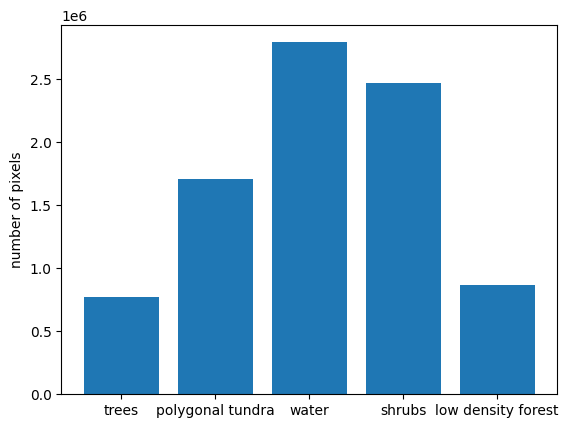

In [28]:
fig, ax = plt.subplots()
ax.bar(range(V), [trees_mask.sum(), poly_mask.sum(), water_mask.sum(), shrubs_mask.sum(), low_mask.sum()])
ax.set_xticks((0, 1, 2, 3, 4))
ax.set_xticklabels(('trees', 'polygonal tundra', 'water', 'shrubs', 'low density forest'))
plt.ylabel('number of pixels')
plt.show()

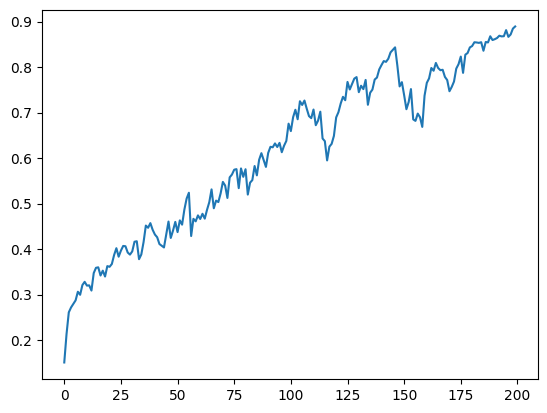

In [29]:
plt.plot(history.history['iou'])

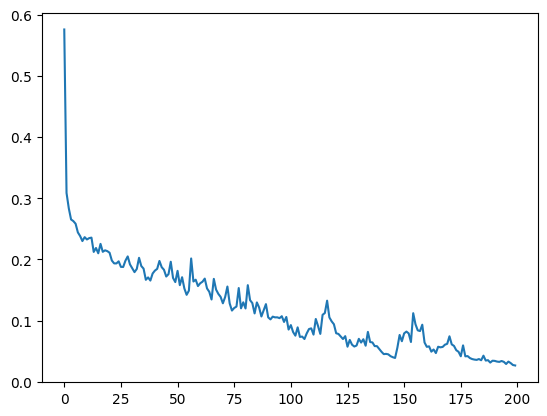

In [30]:
plt.plot(history.history['loss'])

In [35]:
Y_pred = model.predict_on_batch(Y_train_img)

2023-07-12 14:55:38.916171: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype float and shape [159,256,256,1]
	 [[{{node Placeholder/_0}}]]


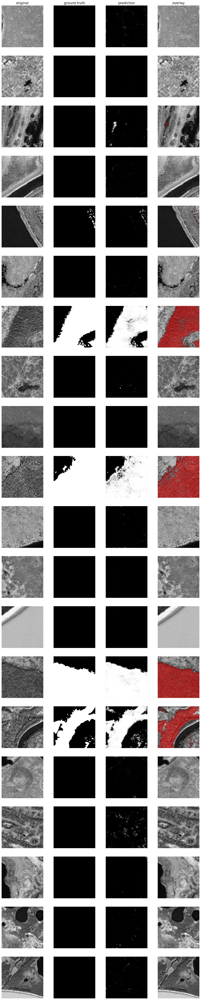

In [36]:
from keras_unet.utils import plot_imgs

# Trees
plot_imgs(
    org_imgs=Y_train_img, 
    mask_imgs=Y[:, :, :, 0], 
    pred_imgs=Y_pred[:, :, :, 0], 
    nm_img_to_plot=20
  )

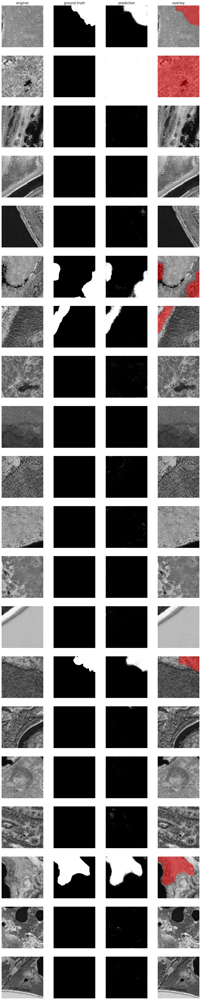

In [37]:
# Polygonal Tundra
plot_imgs(
    org_imgs=Y_train_img, 
    mask_imgs=Y[:, :, :, 1], 
    pred_imgs=Y_pred[:, :, :, 1], 
    nm_img_to_plot=20
  )

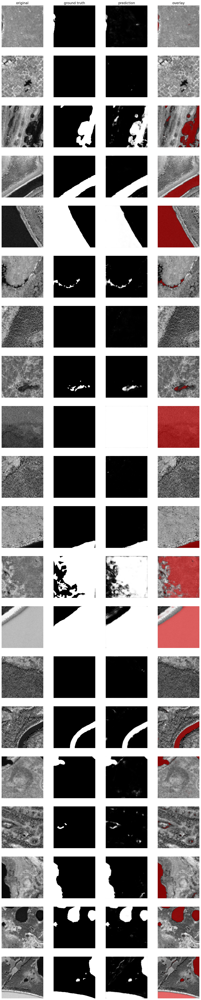

In [38]:
# Water
plot_imgs(
    org_imgs=Y_train_img, 
    mask_imgs=Y[:, :, :, 2], 
    pred_imgs=Y_pred[:, :, :, 2], 
    nm_img_to_plot=20
  )

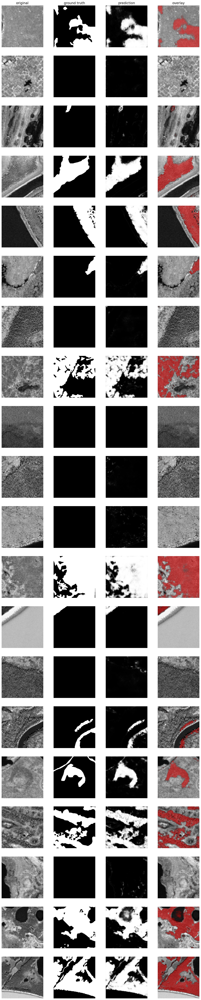

In [39]:
# Shrubs
plot_imgs(
    org_imgs=Y_train_img, 
    mask_imgs=Y[:, :, :, 3], 
    pred_imgs=Y_pred[:, :, :, 3], 
    nm_img_to_plot=20
  )

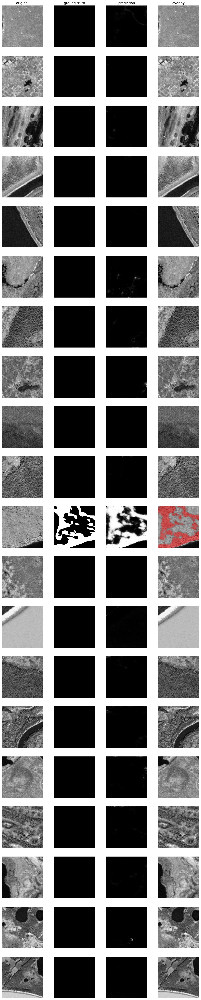

In [40]:
# Low density forest
plot_imgs(
    org_imgs=Y_train_img, 
    mask_imgs=Y[:, :, :, 4], 
    pred_imgs=Y_pred[:, :, :, 4], 
    nm_img_to_plot=20
  )

In [79]:
valid_pred = model.predict(Y_valid_img)

2/2 [==============================] - 2s 471ms/step


In [80]:
valid_pred[1,:, :, 0]

array([[2.9905584e-02, 5.5926270e-03, 3.1561106e-03, ..., 6.3557196e-01,
        4.5117596e-01, 3.8260975e-01],
       [3.1399960e-03, 2.1489922e-04, 5.3268886e-04, ..., 8.1814986e-01,
        6.5285826e-01, 5.3288078e-01],
       [2.9386089e-03, 6.7919632e-04, 3.0182223e-04, ..., 7.8900743e-01,
        7.8414172e-01, 7.6765162e-01],
       ...,
       [6.4202002e-04, 5.5394121e-06, 4.8739607e-06, ..., 9.0240798e-04,
        4.4179944e-04, 1.9879974e-03],
       [4.5882937e-04, 1.3189537e-04, 1.4817935e-05, ..., 8.9619571e-04,
        1.3248414e-03, 1.0848060e-02],
       [1.9933719e-03, 1.8623493e-03, 1.0774419e-04, ..., 6.6668820e-03,
        1.0684253e-02, 5.8618877e-02]], dtype=float32)

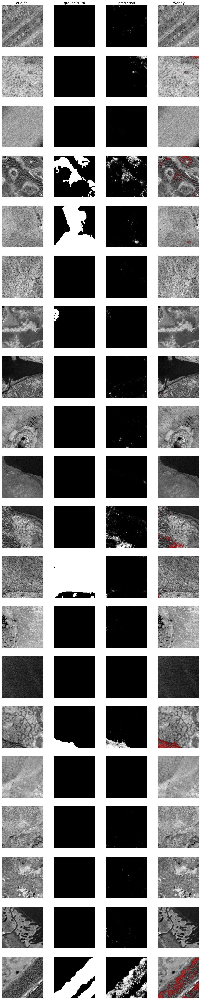

In [81]:
# Trees
plot_imgs(
    org_imgs=Y_valid_img, 
    mask_imgs=Y_valid[:, :, :, 0], 
    pred_imgs=valid_pred[:, :, :, 0], 
    nm_img_to_plot=20
  )

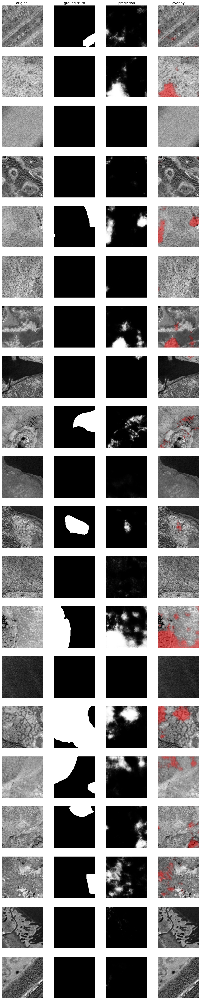

In [82]:
# Polygonal Tundra
plot_imgs(
    org_imgs=Y_valid_img, 
    mask_imgs=Y_valid[:, :, :, 1], 
    pred_imgs=valid_pred[:, :, :, 1], 
    nm_img_to_plot=20
  )

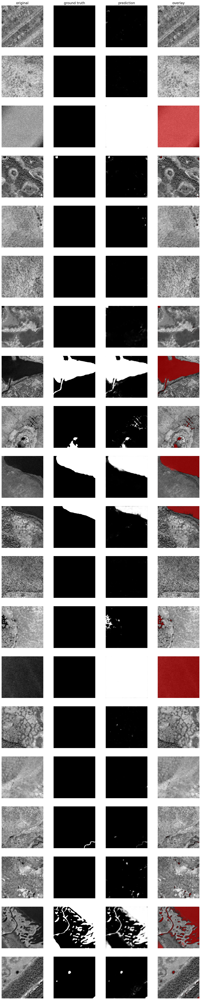

In [83]:
# Water
plot_imgs(
    org_imgs=Y_valid_img, 
    mask_imgs=Y_valid[:, :, :, 2], 
    pred_imgs=valid_pred[:, :, :, 2], 
    nm_img_to_plot=20
  )

In [109]:
waterPredict = valid_pred[:,:,:,2]

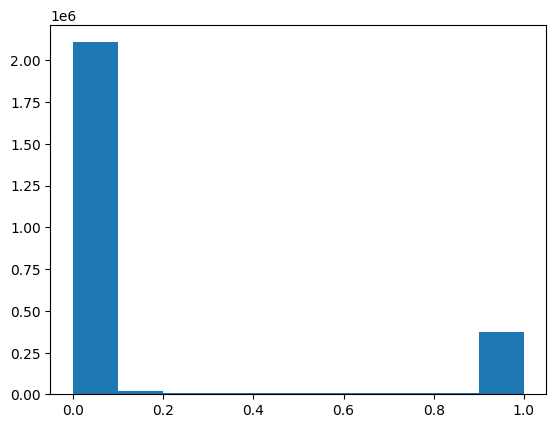

In [110]:
plt.hist(waterPredict.flatten())
plt.show()

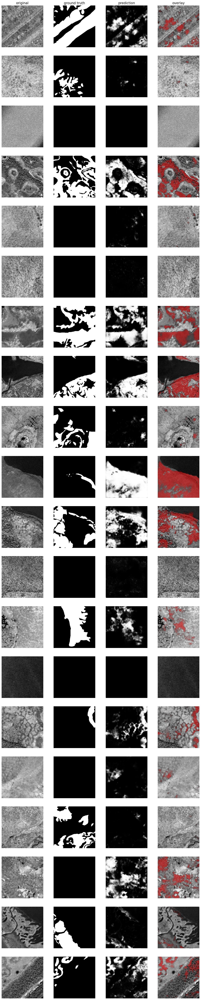

In [84]:
# Shrubs
plot_imgs(
    org_imgs=Y_valid_img, 
    mask_imgs=Y_valid[:, :, :, 3], 
    pred_imgs=valid_pred[:, :, :, 3], 
    nm_img_to_plot=20
  )

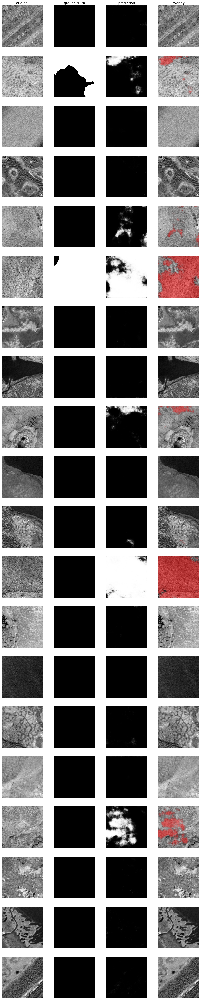

In [85]:
# Low density forest
plot_imgs(
    org_imgs=Y_valid_img, 
    mask_imgs=Y_valid[:, :, :, 4], 
    pred_imgs=valid_pred[:, :, :, 4], 
    nm_img_to_plot=20
  )

In [86]:
Y_valid[0,0,0,0]

0

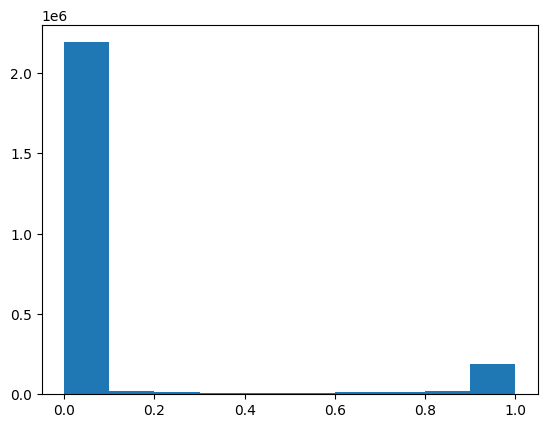

In [88]:
plt.hist(treePredict.flatten())
plt.show()

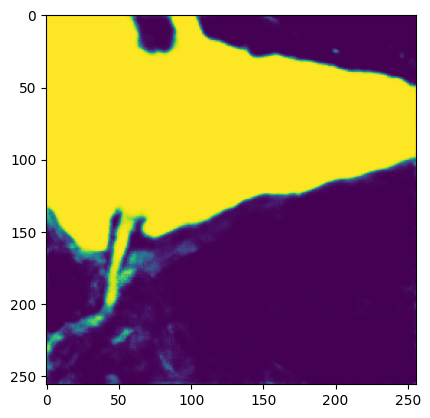

In [113]:
plt.imshow(valid_pred[7,:, :,2])

In [89]:
base_dirP = Path(r'/media/studentuser/PATRIOT/training/img')

In [90]:
J, N, M = 200, 256, 256

In [91]:
predict_img = load_stack_safely((J, N, M), np.float32,base_dirP, "img")

In [92]:
predict_img.shape

(200, 256, 256)

In [93]:
driver = gdal.GetDriverByName("GTiff")

In [94]:
driver.Register()

2

In [114]:
def load_stack_nt(shape, dtype, img_dir, prefix):
    stack = np.zeros(shape=shape, dtype=dtype)
    for i in range(shape[0]):
        image_path = make_path(img_dir, prefix, i + 1)
        stack[i, :, :] = load_image_no_trim(image_path)
    return stack

In [115]:
def save_predict_validT( nImg, xdim,ydim, img_dir, prefix, orig_dir, prefix_orig):
    for i in range(160,174):
        image_path = make_path(img_dir, prefix, i + 1)
        orig_path = make_path(orig_dir, prefix_orig, i + 1) 
        orig_ds = gdal.Open(orig_path)
        gt = orig_ds.GetGeoTransform()
        pt = orig_ds.GetProjection()
        outTree = driver.Create(image_path, xsize=xdim, ysize=ydim,
                             bands=1, eType=gdal.GDT_Float32)
        outTree.SetGeoTransform(gt)
        outTree.SetProjection(pt)
        outBandTree = outTree.GetRasterBand(1)
        outBandTree.WriteArray(valid_pred[i-160,:,:,0])
        outBandTree.SetNoDataValue(np.nan)
        outBandTree.FlushCache()
        outBandTree = None
        outTree = None
                   
    for i in range(175,(160+nImg+1)):
        image_path = make_path(img_dir, prefix, i + 1)
        orig_path = make_path(orig_dir, prefix_orig, i + 1) 
        orig_ds = gdal.Open(orig_path)
        gt = orig_ds.GetGeoTransform()
        pt = orig_ds.GetProjection()
        outTree = driver.Create(image_path, xsize=xdim, ysize=ydim,
                             bands=1, eType=gdal.GDT_Float32)
        outTree.SetGeoTransform(gt)
        outTree.SetProjection(pt)
        outBandTree = outTree.GetRasterBand(1)
        outBandTree.WriteArray(valid_pred[i-161,:,:,0])
        outBandTree.SetNoDataValue(np.nan)
        outBandTree.FlushCache()
        outBandTree = None
        outTree = None

In [116]:
tree_valid_dir = r'/media/studentuser/PATRIOT/predictions_71/valid/tree'
save_predict_valid(nImg = 39,xdim= 256, ydim= 256,img_dir = tree_valid_dir,prefix = "tree_predict",orig_dir = image_dir , prefix_orig = "img")

In [117]:
def save_predict_validP( nImg, xdim,ydim, img_dir, prefix, orig_dir, prefix_orig):
    for i in range(160,174):
        image_path = make_path(img_dir, prefix, i + 1)
        orig_path = make_path(orig_dir, prefix_orig, i + 1) 
        orig_ds = gdal.Open(orig_path)
        gt = orig_ds.GetGeoTransform()
        pt = orig_ds.GetProjection()
        outTree = driver.Create(image_path, xsize=xdim, ysize=ydim,
                             bands=1, eType=gdal.GDT_Float32)
        outTree.SetGeoTransform(gt)
        outTree.SetProjection(pt)
        outBandTree = outTree.GetRasterBand(1)
        outBandTree.WriteArray(valid_pred[i-160,:,:,1])
        outBandTree.SetNoDataValue(np.nan)
        outBandTree.FlushCache()
        outBandTree = None
        outTree = None
                   
    for i in range(175,(160+nImg+1)):
        image_path = make_path(img_dir, prefix, i + 1)
        orig_path = make_path(orig_dir, prefix_orig, i + 1) 
        orig_ds = gdal.Open(orig_path)
        gt = orig_ds.GetGeoTransform()
        pt = orig_ds.GetProjection()
        outTree = driver.Create(image_path, xsize=xdim, ysize=ydim,
                             bands=1, eType=gdal.GDT_Float32)
        outTree.SetGeoTransform(gt)
        outTree.SetProjection(pt)
        outBandTree = outTree.GetRasterBand(1)
        outBandTree.WriteArray(valid_pred[i-161,:,:,1])
        outBandTree.SetNoDataValue(np.nan)
        outBandTree.FlushCache()
        outBandTree = None
        outTree = None

In [118]:
poly_valid_dir = r'/media/studentuser/PATRIOT/predictions_71/valid/poly'
save_predict_validP(nImg = 39,xdim= 256, ydim= 256,img_dir = poly_valid_dir,prefix = "poly_predict",orig_dir = image_dir , prefix_orig = "img")

In [119]:
def save_predict_validW( nImg, xdim,ydim, img_dir, prefix, orig_dir, prefix_orig):
    for i in range(160,174):
        image_path = make_path(img_dir, prefix, i + 1)
        orig_path = make_path(orig_dir, prefix_orig, i + 1) 
        orig_ds = gdal.Open(orig_path)
        gt = orig_ds.GetGeoTransform()
        pt = orig_ds.GetProjection()
        outTree = driver.Create(image_path, xsize=xdim, ysize=ydim,
                             bands=1, eType=gdal.GDT_Float32)
        outTree.SetGeoTransform(gt)
        outTree.SetProjection(pt)
        outBandTree = outTree.GetRasterBand(1)
        outBandTree.WriteArray(valid_pred[i-160,:,:,2])
        outBandTree.SetNoDataValue(np.nan)
        outBandTree.FlushCache()
        outBandTree = None
        outTree = None
                   
    for i in range(175,(160+nImg+1)):
        image_path = make_path(img_dir, prefix, i + 1)
        orig_path = make_path(orig_dir, prefix_orig, i + 1) 
        orig_ds = gdal.Open(orig_path)
        gt = orig_ds.GetGeoTransform()
        pt = orig_ds.GetProjection()
        outTree = driver.Create(image_path, xsize=xdim, ysize=ydim,
                             bands=1, eType=gdal.GDT_Float32)
        outTree.SetGeoTransform(gt)
        outTree.SetProjection(pt)
        outBandTree = outTree.GetRasterBand(1)
        outBandTree.WriteArray(valid_pred[i-161,:,:,2])
        outBandTree.SetNoDataValue(np.nan)
        outBandTree.FlushCache()
        outBandTree = None
        outTree = None

In [120]:
water_valid_dir = r'/media/studentuser/PATRIOT/predictions_71/valid/water'
save_predict_validW(nImg = 39,xdim= 256, ydim= 256,img_dir = water_valid_dir,prefix = "water_predict",orig_dir = image_dir , prefix_orig = "img")

In [121]:
def save_predict_validS( nImg, xdim,ydim, img_dir, prefix, orig_dir, prefix_orig):
    for i in range(160,174):
        image_path = make_path(img_dir, prefix, i + 1)
        orig_path = make_path(orig_dir, prefix_orig, i + 1) 
        orig_ds = gdal.Open(orig_path)
        gt = orig_ds.GetGeoTransform()
        pt = orig_ds.GetProjection()
        outTree = driver.Create(image_path, xsize=xdim, ysize=ydim,
                             bands=1, eType=gdal.GDT_Float32)
        outTree.SetGeoTransform(gt)
        outTree.SetProjection(pt)
        outBandTree = outTree.GetRasterBand(1)
        outBandTree.WriteArray(valid_pred[i-160,:,:,3])
        outBandTree.SetNoDataValue(np.nan)
        outBandTree.FlushCache()
        outBandTree = None
        outTree = None
                   
    for i in range(175,(160+nImg+1)):
        image_path = make_path(img_dir, prefix, i + 1)
        orig_path = make_path(orig_dir, prefix_orig, i + 1) 
        orig_ds = gdal.Open(orig_path)
        gt = orig_ds.GetGeoTransform()
        pt = orig_ds.GetProjection()
        outTree = driver.Create(image_path, xsize=xdim, ysize=ydim,
                             bands=1, eType=gdal.GDT_Float32)
        outTree.SetGeoTransform(gt)
        outTree.SetProjection(pt)
        outBandTree = outTree.GetRasterBand(1)
        outBandTree.WriteArray(valid_pred[i-161,:,:,3])
        outBandTree.SetNoDataValue(np.nan)
        outBandTree.FlushCache()
        outBandTree = None
        outTree = None

In [122]:
shrub_valid_dir = r'/media/studentuser/PATRIOT/predictions_71/valid/shrub'
save_predict_validS(nImg = 39,xdim= 256, ydim= 256,img_dir = shrub_valid_dir,prefix = "shrub_predict",orig_dir = image_dir , prefix_orig = "img")

In [123]:
def save_predict_validL( nImg, xdim,ydim, img_dir, prefix, orig_dir, prefix_orig):
    for i in range(160,174):
        image_path = make_path(img_dir, prefix, i + 1)
        orig_path = make_path(orig_dir, prefix_orig, i + 1) 
        orig_ds = gdal.Open(orig_path)
        gt = orig_ds.GetGeoTransform()
        pt = orig_ds.GetProjection()
        outTree = driver.Create(image_path, xsize=xdim, ysize=ydim,
                             bands=1, eType=gdal.GDT_Float32)
        outTree.SetGeoTransform(gt)
        outTree.SetProjection(pt)
        outBandTree = outTree.GetRasterBand(1)
        outBandTree.WriteArray(valid_pred[i-160,:,:,4])
        outBandTree.SetNoDataValue(np.nan)
        outBandTree.FlushCache()
        outBandTree = None
        outTree = None
                   
    for i in range(175,(160+nImg+1)):
        image_path = make_path(img_dir, prefix, i + 1)
        orig_path = make_path(orig_dir, prefix_orig, i + 1) 
        orig_ds = gdal.Open(orig_path)
        gt = orig_ds.GetGeoTransform()
        pt = orig_ds.GetProjection()
        outTree = driver.Create(image_path, xsize=xdim, ysize=ydim,
                             bands=1, eType=gdal.GDT_Float32)
        outTree.SetGeoTransform(gt)
        outTree.SetProjection(pt)
        outBandTree = outTree.GetRasterBand(1)
        outBandTree.WriteArray(valid_pred[i-161,:,:,4])
        outBandTree.SetNoDataValue(np.nan)
        outBandTree.FlushCache()
        outBandTree = None
        outTree = None

In [124]:
lowD_valid_dir = r'/media/studentuser/PATRIOT/predictions_71/valid/lowD'
save_predict_validL(nImg = 198,xdim= 256, ydim= 256,img_dir = lowD_valid_dir,prefix = "lowD_predict",orig_dir = image_dir , prefix_orig = "img")

ERROR 4: /media/studentuser/PATRIOT/training/img/img_201.tif: No such file or directory


AttributeError: 'NoneType' object has no attribute 'GetGeoTransform'